In [1]:
import sys
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from functions import *
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.cbook as cbook
import os, csv, requests
import math

In [2]:
load_ext autoreload

In [3]:
autoreload 2

In [4]:
## data
#filename = "../../data/covid_data.csv"
#df_all = pd.read_csv(filename)  

# Note that the results may be slightly different because the dataset of past dates was updated day-by-day.
filename = "../../data/covid_data.xlsx"
df_all = pd.read_excel(filename)  

In [5]:
category = 'cases' ## we only studied the time series of cases

In [6]:
## list of countries with no less than 10,000 cumulative cases by Apr. 30
candidates_country = ['Austria'
                      , 'Belarus', 'Belgium', 'Brazil', 
                      'Canada', 'Chile', 'China', 'Ecuador', 'France', 'Germany', 
                      'India', 'Indonesia', 'Iran', 'Ireland', 'Israel', 'Italy', 'Japan', 
                      'Mexico', 'Netherlands', 
                      'Pakistan', 'Peru', 'Poland', 'Portugal',
                      'Qatar', 'Romania', 'Russia', 'Saudi_Arabia', 
                      'Singapore', 'South_Korea', 'Spain', 'Sweden', 
                      'Switzerland', 'Turkey', 'Ukraine', 'United_Arab_Emirates',
                      'United_Kingdom', 'United_States_of_America']

In [7]:
df_candidates = pd.DataFrame(columns=['country', 'date', 'cases'])
for index, row in df_all.iterrows():
    if row['countriesAndTerritories'] in candidates_country:
        date = datetime(row['year'], row['month'], row['day'])
        df_candidates = df_candidates.append({'country': row['countriesAndTerritories'], 'date': date, 
                                             'cases': row['cases']},
                                             ignore_index=True)

## Learn delta from the initial event for the 1st and the 2nd D-MDL

In [8]:
#We calcuated the delta using the inital event in Japan and applied it to all the other countries
#The initial warning for Japan was set on Feb. 27 2020 when the government required closing elementary, junior high, and high schools
#We were concerned several days before the date of the initial event since there may exist delays in announcing the event

t = np.arange(datetime(2020, 2, 17), datetime(2020, 2, 28), timedelta(days=1))

In [9]:
## daily new cases
case_values = []
for date_tmp in t:
        row = df_candidates.loc[(df_candidates['country'] == 'Japan') & (df_candidates['date'] == date_tmp)]
        if  len(row[category].values) > 0 and (row[category].values[0] > 0):
            case_values.append(row[category].values[0])
        else:
            case_values.append(0)

In [10]:
case_values

[7, 0, 7, 18, 9, 12, 27, 12, 0, 20, 22]

In [11]:
## Calculating the delta for the 1st D-MDL
for i in range(5,len(case_values)):
    score,_ =  MDL_gaussian_1th(case_values[i-5:i])
    delta = delta_First_NML(score, 2, 5)
    print('change score:{0:.4f}, delta:{1:.4f}'.format(score, delta))

change score:0.6117, delta:3.3901
change score:-0.3548, delta:8.9117
change score:0.8744, delta:2.6069
change score:0.8878, delta:2.5723
change score:-1.7573, delta:36.2283
change score:-0.1240, delta:7.0749


In [12]:
## Calculating the delta for the 2nd D-MDL
for i in range(6,len(case_values)):
    score,_ =  MDL_gaussian_2nd(case_values[i-6:i])
    delta = delta_Second_NML(score, 2, 6)
    print('change score:{0:.4f}, delta:{1:.4f}'.format(score, delta))

change score:-1.1475, delta:15.9742
change score:2.9474, delta:2.0617
change score:0.4247, delta:7.2781
change score:-0.7745, delta:13.2567
change score:2.8117, delta:2.2064


In [13]:
#All the change scores that are less than zero are not meaningful
#All the delta are calcuated to be larger than one
#In the following experiment, it was set to be 0.99 because of the concept of confidence parameter

## Online detection

In [14]:
## The date on which the social distancing was implemented for individual countries
event_dict = {}
event_dict['Austria'] = datetime(2020, 3, 16)
event_dict['Belarus'] = datetime(2020, 4, 9)
event_dict['Belgium'] = datetime(2020, 3, 18)
event_dict['Brazil'] = datetime(2020, 3, 24)
event_dict['Canada'] = datetime(2020, 3, 17)
event_dict['Chile'] = datetime(2020, 3, 26)
event_dict['China'] = datetime(2020, 1, 23)
#event_dict['Ecuador'] = datetime(2020, 3, 16)
event_dict['France'] = datetime(2020, 3, 17)
event_dict['Germany'] = datetime(2020, 3, 16)
event_dict['India'] = datetime(2020, 3, 25)
event_dict['Indonesia'] = datetime(2020, 4, 6)
event_dict['Iran'] = datetime(2020, 3, 24)
event_dict['Ireland'] = datetime(2020, 3, 12)
event_dict['Israel'] = datetime(2020, 3, 15)
event_dict['Italy'] = datetime(2020, 3, 9)
event_dict['Japan'] = datetime(2020, 4, 7)
event_dict['Mexico'] = datetime(2020, 3, 23)
event_dict['Netherlands'] = datetime(2020, 3, 15)
event_dict['Pakistan'] = datetime(2020, 3, 24)
event_dict['Peru'] = datetime(2020, 3, 16) 
event_dict['Poland'] = datetime(2020, 3, 24)
event_dict['Portugal'] = datetime(2020, 3, 19)
event_dict['Qatar'] = datetime(2020, 3, 23)
event_dict['Romania'] = datetime(2020, 3, 23)
event_dict['Russia'] = datetime(2020, 3, 30)
event_dict['Saudi_Arabia'] = datetime(2020, 3, 24)
event_dict['Singapore'] = datetime(2020, 4, 7)
event_dict['South_Korea'] = datetime(2020, 2, 25)
event_dict['Spain'] = datetime(2020, 3, 13)
event_dict['Sweden'] = datetime(2020, 3, 24)
event_dict['Switzerland'] = datetime(2020, 3, 16)
event_dict['Turkey'] = datetime(2020, 3, 21)
event_dict['Ukraine'] = datetime(2020, 3, 25)
event_dict['United_Arab_Emirates'] = datetime(2020, 3, 31)
event_dict['United_Kingdom'] = datetime(2020, 3,24)
event_dict['United_States_of_America'] = datetime(2020, 3, 19)

set_no_event = []
for country in candidates_country:
    if country not in event_dict:
        set_no_event.append(country)
        
delta = 0.05 ## delta for 0th
delta_first = 0.99 ## delta for 1st
delta_second = 0.99 ## delta for 2nd
dimension = 2 ## dimension of the univariate Gaussian
font_size = 36 ## figure font size
output_path = '../../gaussian_figs/' ## output path of the figures
os.makedirs(output_path, exist_ok=True)

country: Austria


/Users/ryo/.local/lib/python3.6/site-packages/numpy/core/fromnumeric.py:3257: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/ryo/.local/lib/python3.6/site-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


[numpy.datetime64('2020-02-26T00:00:00.000000'), numpy.datetime64('2020-02-27T00:00:00.000000'), numpy.datetime64('2020-02-28T00:00:00.000000'), numpy.datetime64('2020-02-29T00:00:00.000000'), numpy.datetime64('2020-03-01T00:00:00.000000'), numpy.datetime64('2020-03-02T00:00:00.000000'), numpy.datetime64('2020-03-03T00:00:00.000000'), numpy.datetime64('2020-03-04T00:00:00.000000'), numpy.datetime64('2020-03-05T00:00:00.000000'), numpy.datetime64('2020-03-06T00:00:00.000000'), numpy.datetime64('2020-03-07T00:00:00.000000'), numpy.datetime64('2020-03-08T00:00:00.000000'), numpy.datetime64('2020-03-09T00:00:00.000000'), numpy.datetime64('2020-03-10T00:00:00.000000'), numpy.datetime64('2020-03-11T00:00:00.000000'), numpy.datetime64('2020-03-12T00:00:00.000000'), numpy.datetime64('2020-03-13T00:00:00.000000'), numpy.datetime64('2020-03-14T00:00:00.000000'), numpy.datetime64('2020-03-15T00:00:00.000000'), numpy.datetime64('2020-03-16T00:00:00.000000'), numpy.datetime64('2020-03-17T00:00:00.0

/Users/ryo/Desktop/cpdetection/differential-mdl-change-statistics/jupyter/symptom/functions.py:46: RuntimeWarning: divide by zero encountered in log
  change_score = window_size * np.log(std_all) - h * np.log(std_before) - (window_size - h) * np.log(std_after) + normalizer_MDL(2, window_size) - normalizer_MDL(2, h) - normalizer_MDL(2, window_size - h)
/Users/ryo/.pyenv/versions/anaconda3-5.3.1/envs/wantedly/lib/python3.6/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


date:2020-04-03T00:00:00.000000, window size:15, threshold:11.255285386915732, MDL score:2.3202973772933633
frist-orde change: date:2020-04-03T00:00:00.000000, threshold:4.0398563769380305, MDL score:2.5379514996046604
second-orde change: date:2020-04-03T00:00:00.000000, threshold:8.079712753876061, MDL score:2.981770773061899
date:2020-04-04T00:00:00.000000, window size:16, threshold:11.452127876385322, MDL score:5.538780418928377
frist-orde change: date:2020-04-04T00:00:00.000000, threshold:4.168933419213173, MDL score:2.9171415828267735
second-orde change: date:2020-04-04T00:00:00.000000, threshold:8.337866838426345, MDL score:3.4280545278196124
date:2020-04-05T00:00:00.000000, window size:17, threshold:11.63703297292545, MDL score:3.347248537723357
frist-orde change: date:2020-04-05T00:00:00.000000, threshold:4.290182662846043, MDL score:2.315839121756191
second-orde change: date:2020-04-05T00:00:00.000000, threshold:8.580365325692085, MDL score:2.665316730044098
date:2020-04-06T00

country: Belgium
[numpy.datetime64('2020-03-01T00:00:00.000000'), numpy.datetime64('2020-03-02T00:00:00.000000'), numpy.datetime64('2020-03-03T00:00:00.000000'), numpy.datetime64('2020-03-04T00:00:00.000000'), numpy.datetime64('2020-03-05T00:00:00.000000'), numpy.datetime64('2020-03-06T00:00:00.000000'), numpy.datetime64('2020-03-07T00:00:00.000000'), numpy.datetime64('2020-03-08T00:00:00.000000'), numpy.datetime64('2020-03-09T00:00:00.000000'), numpy.datetime64('2020-03-10T00:00:00.000000'), numpy.datetime64('2020-03-11T00:00:00.000000'), numpy.datetime64('2020-03-12T00:00:00.000000'), numpy.datetime64('2020-03-13T00:00:00.000000'), numpy.datetime64('2020-03-14T00:00:00.000000'), numpy.datetime64('2020-03-15T00:00:00.000000'), numpy.datetime64('2020-03-16T00:00:00.000000'), numpy.datetime64('2020-03-17T00:00:00.000000'), numpy.datetime64('2020-03-18T00:00:00.000000'), numpy.datetime64('2020-03-19T00:00:00.000000'), numpy.datetime64('2020-03-20T00:00:00.000000'), numpy.datetime64('2020

date:2020-04-13T00:00:00.000000, window size:19, threshold:11.976271160011633, MDL score:2.1676937957928955
frist-orde change: date:2020-04-13T00:00:00.000000, threshold:4.512633933066492, MDL score:1.6068948477132203
second-orde change: date:2020-04-13T00:00:00.000000, threshold:9.025267866132983, MDL score:2.36200561792168
date:2020-04-14T00:00:00.000000, window size:20, threshold:12.132715707893661, MDL score:9.971864063993985
frist-orde change: date:2020-04-14T00:00:00.000000, threshold:4.615220521841593, MDL score:6.793311989331615
second-orde change: date:2020-04-14T00:00:00.000000, threshold:9.230441043683186, MDL score:4.119724679423611
date:2020-04-15T00:00:00.000000, window size:21, threshold:12.28152570861043, MDL score:2.1676155515534283
frist-orde change: date:2020-04-15T00:00:00.000000, threshold:4.712800850180456, MDL score:1.013852461682617
second-orde change: date:2020-04-15T00:00:00.000000, threshold:9.425601700360913, MDL score:1.6217487868096716
date:2020-04-16T00:0

frist-orde change: date:2020-04-23T00:00:00.000000, threshold:4.712800850180456, MDL score:2.576136276505091
second-orde change: date:2020-04-23T00:00:00.000000, threshold:9.425601700360913, MDL score:4.304692152152208
date:2020-04-24T00:00:00.000000, window size:22, threshold:12.423411756296854, MDL score:9.796255103551152
frist-orde change: date:2020-04-24T00:00:00.000000, threshold:4.8058408814502425, MDL score:2.492545676465972
second-orde change: date:2020-04-24T00:00:00.000000, threshold:9.611681762900485, MDL score:4.824486790230019
date:2020-04-25T00:00:00.000000, window size:23, threshold:12.558989632137896, MDL score:10.96569866625445
frist-orde change: date:2020-04-25T00:00:00.000000, threshold:4.89474440659191, MDL score:2.5473296360916056
second-orde change: date:2020-04-25T00:00:00.000000, threshold:9.78948881318382, MDL score:5.0408250425979855
date:2020-04-26T00:00:00.000000, window size:24, threshold:12.688796456115224, MDL score:11.956059211009785
frist-orde change: d

second-orde change: date:2020-04-19T00:00:00.000000, threshold:7.803741267928256, MDL score:1.2757815983106566
date:2020-04-20T00:00:00.000000, window size:15, threshold:11.255285386915732, MDL score:3.5778647619596633
frist-orde change: date:2020-04-20T00:00:00.000000, threshold:4.0398563769380305, MDL score:2.8265442013824638
second-orde change: date:2020-04-20T00:00:00.000000, threshold:8.079712753876061, MDL score:5.009508633703824
date:2020-04-21T00:00:00.000000, window size:16, threshold:11.452127876385322, MDL score:4.797717342923204
frist-orde change: date:2020-04-21T00:00:00.000000, threshold:4.168933419213173, MDL score:1.5620032415787866
second-orde change: date:2020-04-21T00:00:00.000000, threshold:8.337866838426345, MDL score:2.616419156594815
date:2020-04-22T00:00:00.000000, window size:17, threshold:11.63703297292545, MDL score:4.903156686247426
frist-orde change: date:2020-04-22T00:00:00.000000, threshold:4.290182662846043, MDL score:1.5518910495386766
second-orde chang

/Users/ryo/.pyenv/versions/anaconda3-5.3.1/envs/wantedly/lib/python3.6/site-packages/ipykernel_launcher.py:261: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/ryo/.pyenv/versions/anaconda3-5.3.1/envs/wantedly/lib/python3.6/site-packages/ipykernel_launcher.py:293: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/Users/ryo/.pyenv/versions/anaconda3-5.3.1/envs/wantedly/lib/python3.6/site-packages/ipykernel_launcher.py:341: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure

country: Chile
[numpy.datetime64('2020-03-09T00:00:00.000000'), numpy.datetime64('2020-03-10T00:00:00.000000'), numpy.datetime64('2020-03-11T00:00:00.000000'), numpy.datetime64('2020-03-12T00:00:00.000000'), numpy.datetime64('2020-03-13T00:00:00.000000'), numpy.datetime64('2020-03-14T00:00:00.000000'), numpy.datetime64('2020-03-15T00:00:00.000000'), numpy.datetime64('2020-03-16T00:00:00.000000'), numpy.datetime64('2020-03-17T00:00:00.000000'), numpy.datetime64('2020-03-18T00:00:00.000000'), numpy.datetime64('2020-03-19T00:00:00.000000'), numpy.datetime64('2020-03-20T00:00:00.000000'), numpy.datetime64('2020-03-21T00:00:00.000000'), numpy.datetime64('2020-03-22T00:00:00.000000'), numpy.datetime64('2020-03-23T00:00:00.000000'), numpy.datetime64('2020-03-24T00:00:00.000000'), numpy.datetime64('2020-03-25T00:00:00.000000'), numpy.datetime64('2020-03-26T00:00:00.000000'), numpy.datetime64('2020-03-27T00:00:00.000000'), numpy.datetime64('2020-03-28T00:00:00.000000'), numpy.datetime64('2020-0

frist-orde change: date:2020-04-18T00:00:00.000000, threshold:4.615220521841593, MDL score:1.8394418782427475
second-orde change: date:2020-04-18T00:00:00.000000, threshold:9.230441043683186, MDL score:2.7640432511051864
date:2020-04-19T00:00:00.000000, window size:21, threshold:12.28152570861043, MDL score:4.349209654024718
frist-orde change: date:2020-04-19T00:00:00.000000, threshold:4.712800850180456, MDL score:2.31242291876272
second-orde change: date:2020-04-19T00:00:00.000000, threshold:9.425601700360913, MDL score:2.8735341493542856
date:2020-04-20T00:00:00.000000, window size:22, threshold:12.423411756296854, MDL score:4.331569939216
frist-orde change: date:2020-04-20T00:00:00.000000, threshold:4.8058408814502425, MDL score:1.3600347496733836
second-orde change: date:2020-04-20T00:00:00.000000, threshold:9.611681762900485, MDL score:2.847310169042805
date:2020-04-21T00:00:00.000000, window size:23, threshold:12.558989632137896, MDL score:4.521535191967578
frist-orde change: dat

date:2020-01-03T00:00:00.000000, window size:0, MDL score:0
date:2020-01-04T00:00:00.000000, window size:1, MDL score:0
date:2020-01-05T00:00:00.000000, window size:2, MDL score:0
date:2020-01-06T00:00:00.000000, window size:3, MDL score:0
date:2020-01-07T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-01-08T00:00:00.000000, window size:1, MDL score:0
date:2020-01-09T00:00:00.000000, window size:2, MDL score:0
date:2020-01-10T00:00:00.000000, window size:3, MDL score:0
date:2020-01-11T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:-10000
date:2020-01-12T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:-10000
frist-orde change: date:2020-01-12T00:00:00.000000, threshold:1.8426317996018118, MDL score:-10000
date:2020-01-13T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:-10000
frist-orde change: date:2020-01-13T00:00:00.000000, threshold:2.207274913189721, MDL score:-10000
second-o

/Users/ryo/Desktop/cpdetection/differential-mdl-change-statistics/jupyter/symptom/functions.py:46: RuntimeWarning: invalid value encountered in double_scalars
  change_score = window_size * np.log(std_all) - h * np.log(std_before) - (window_size - h) * np.log(std_after) + normalizer_MDL(2, window_size) - normalizer_MDL(2, h) - normalizer_MDL(2, window_size - h)
/Users/ryo/Desktop/cpdetection/differential-mdl-change-statistics/jupyter/symptom/functions.py:69: RuntimeWarning: invalid value encountered in double_scalars
  score_tmp = NML_gaussian(window, cut + 1) - NML_gaussian(window, cut)
/Users/ryo/Desktop/cpdetection/differential-mdl-change-statistics/jupyter/symptom/functions.py:81: RuntimeWarning: invalid value encountered in double_scalars
  score_tmp = NML_gaussian(window, cut + 1) - 2 * NML_gaussian(window, cut) + NML_gaussian(window, cut - 1)


country: Ecuador
[numpy.datetime64('2020-03-01T00:00:00.000000'), numpy.datetime64('2020-03-02T00:00:00.000000'), numpy.datetime64('2020-03-03T00:00:00.000000'), numpy.datetime64('2020-03-04T00:00:00.000000'), numpy.datetime64('2020-03-05T00:00:00.000000'), numpy.datetime64('2020-03-06T00:00:00.000000'), numpy.datetime64('2020-03-07T00:00:00.000000'), numpy.datetime64('2020-03-08T00:00:00.000000'), numpy.datetime64('2020-03-09T00:00:00.000000'), numpy.datetime64('2020-03-10T00:00:00.000000'), numpy.datetime64('2020-03-11T00:00:00.000000'), numpy.datetime64('2020-03-12T00:00:00.000000'), numpy.datetime64('2020-03-13T00:00:00.000000'), numpy.datetime64('2020-03-14T00:00:00.000000'), numpy.datetime64('2020-03-15T00:00:00.000000'), numpy.datetime64('2020-03-16T00:00:00.000000'), numpy.datetime64('2020-03-17T00:00:00.000000'), numpy.datetime64('2020-03-18T00:00:00.000000'), numpy.datetime64('2020-03-19T00:00:00.000000'), numpy.datetime64('2020-03-20T00:00:00.000000'), numpy.datetime64('2020

second-orde change: date:2020-04-05T00:00:00.000000, threshold:8.80899898105188, MDL score:4.86642140293327
date:2020-04-06T00:00:00.000000, window size:19, threshold:11.976271160011633, MDL score:4.542983437104264
frist-orde change: date:2020-04-06T00:00:00.000000, threshold:4.512633933066492, MDL score:1.5833764007706828
second-orde change: date:2020-04-06T00:00:00.000000, threshold:9.025267866132983, MDL score:4.8718009829075
date:2020-04-07T00:00:00.000000, window size:20, threshold:12.132715707893661, MDL score:4.43271659248301
frist-orde change: date:2020-04-07T00:00:00.000000, threshold:4.615220521841593, MDL score:2.2436785691418
second-orde change: date:2020-04-07T00:00:00.000000, threshold:9.230441043683186, MDL score:4.814599758541428
date:2020-04-08T00:00:00.000000, window size:21, threshold:12.28152570861043, MDL score:4.529256517645667
frist-orde change: date:2020-04-08T00:00:00.000000, threshold:4.712800850180456, MDL score:1.545290664496963
second-orde change: date:2020

second-orde change: date:2020-04-09T00:00:00.000000, threshold:7.187138548619223, MDL score:7.117674741959596
date:2020-04-10T00:00:00.000000, window size:13, threshold:10.818827813811676, MDL score:5.326153348949765
frist-orde change: date:2020-04-10T00:00:00.000000, threshold:3.7536546896566843, MDL score:4.796709570370087
second-orde change: date:2020-04-10T00:00:00.000000, threshold:7.5073093793133685, MDL score:5.101311922202196
date:2020-04-11T00:00:00.000000, window size:14, threshold:11.04485712888053, MDL score:6.3168510872481
frist-orde change: date:2020-04-11T00:00:00.000000, threshold:3.901870633964128, MDL score:5.233449816122628
second-orde change: date:2020-04-11T00:00:00.000000, threshold:7.803741267928256, MDL score:5.6788256549325995
date:2020-04-12T00:00:00.000000, window size:15, threshold:11.255285386915732, MDL score:3.8147403128877655
frist-orde change: date:2020-04-12T00:00:00.000000, threshold:4.0398563769380305, MDL score:2.785956744535981
second-orde change: 

frist-orde change: date:2020-02-26T00:00:00.000000, threshold:3.901870633964128, MDL score:-10000
second-orde change: date:2020-02-26T00:00:00.000000, threshold:7.803741267928256, MDL score:-10000
date:2020-02-27T00:00:00.000000, window size:1, MDL score:0
date:2020-02-28T00:00:00.000000, window size:2, MDL score:0
date:2020-02-29T00:00:00.000000, window size:3, MDL score:0
date:2020-03-01T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.8746428216520404
date:2020-03-02T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:1.6493698921507178
frist-orde change: date:2020-03-02T00:00:00.000000, threshold:1.8426317996018118, MDL score:1.1845155860736278
date:2020-03-03T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:1.4120370604633508
frist-orde change: date:2020-03-03T00:00:00.000000, threshold:2.207274913189721, MDL score:1.0657712431725899
second-orde change: date:2020-03-03T00:00:00.000000, threshold:4.414549826379442, M

second-orde change: date:2020-04-20T00:00:00.000000, threshold:10.983460767407806, MDL score:2.271350221118982
date:2020-04-21T00:00:00.000000, window size:32, threshold:13.566226777093156, MDL score:12.632533239476814
frist-orde change: date:2020-04-21T00:00:00.000000, threshold:5.555227780333063, MDL score:6.844205640942602
second-orde change: date:2020-04-21T00:00:00.000000, threshold:11.110455560666127, MDL score:4.2064526336616535
date:2020-04-22T00:00:00.000000, window size:33, threshold:13.660080336026754, MDL score:13.348241041589558
frist-orde change: date:2020-04-22T00:00:00.000000, threshold:5.616771097666571, MDL score:4.252723897977811
second-orde change: date:2020-04-22T00:00:00.000000, threshold:11.233542195333142, MDL score:3.065960445695291
date:2020-04-23T00:00:00.000000, window size:34, threshold:13.751131873633284, MDL score:14.826015599947604
frist-orde change: date:2020-04-23T00:00:00.000000, threshold:5.6764770239659335, MDL score:4.619698974397718
second-orde ch

frist-orde change: date:2020-04-14T00:00:00.000000, threshold:3.419546520330352, MDL score:1.8063205193516656
second-orde change: date:2020-04-14T00:00:00.000000, threshold:6.839093040660704, MDL score:2.5974234645166456
date:2020-04-15T00:00:00.000000, window size:12, threshold:10.574697555407392, MDL score:6.037126845838794
frist-orde change: date:2020-04-15T00:00:00.000000, threshold:3.5935692743096115, MDL score:2.3567752428322963
second-orde change: date:2020-04-15T00:00:00.000000, threshold:7.187138548619223, MDL score:2.9801541062353385
date:2020-04-16T00:00:00.000000, window size:13, threshold:10.818827813811676, MDL score:6.679127351440583
frist-orde change: date:2020-04-16T00:00:00.000000, threshold:3.7536546896566843, MDL score:2.3077736176173933
second-orde change: date:2020-04-16T00:00:00.000000, threshold:7.5073093793133685, MDL score:3.0841487415583777
date:2020-04-17T00:00:00.000000, window size:14, threshold:11.04485712888053, MDL score:7.666265177692907
frist-orde cha

second-orde change: date:2020-04-25T00:00:00.000000, threshold:7.187138548619223, MDL score:2.1124105135579705
date:2020-04-26T00:00:00.000000, window size:13, threshold:10.818827813811676, MDL score:3.0342973364225347
frist-orde change: date:2020-04-26T00:00:00.000000, threshold:3.7536546896566843, MDL score:2.1073375111304076
second-orde change: date:2020-04-26T00:00:00.000000, threshold:7.5073093793133685, MDL score:2.5640921436846256
date:2020-04-27T00:00:00.000000, window size:14, threshold:11.04485712888053, MDL score:2.860681599510289
frist-orde change: date:2020-04-27T00:00:00.000000, threshold:3.901870633964128, MDL score:1.3544768116657724
second-orde change: date:2020-04-27T00:00:00.000000, threshold:7.803741267928256, MDL score:2.110960128177803
date:2020-04-28T00:00:00.000000, window size:15, threshold:11.255285386915732, MDL score:2.8126775587744093
frist-orde change: date:2020-04-28T00:00:00.000000, threshold:4.0398563769380305, MDL score:2.3303157211862873
second-orde c

frist-orde change: date:2020-03-22T00:00:00.000000, threshold:4.8058408814502425, MDL score:3.897120895969582
second-orde change: date:2020-03-22T00:00:00.000000, threshold:9.611681762900485, MDL score:3.7668712389777967
date:2020-03-23T00:00:00.000000, window size:23, threshold:12.558989632137896, MDL score:9.919179481580425
frist-orde change: date:2020-03-23T00:00:00.000000, threshold:4.89474440659191, MDL score:4.039650548619795
second-orde change: date:2020-03-23T00:00:00.000000, threshold:9.78948881318382, MDL score:3.8514351180360746
date:2020-03-24T00:00:00.000000, window size:24, threshold:12.688796456115224, MDL score:9.886338981179831
frist-orde change: date:2020-03-24T00:00:00.000000, threshold:4.979863635429502, MDL score:3.7650785718896937
second-orde change: date:2020-03-24T00:00:00.000000, threshold:9.959727270859004, MDL score:3.8157353528016777
date:2020-03-25T00:00:00.000000, window size:25, threshold:12.813303539402002, MDL score:8.431403914905449
frist-orde change: 

country: Ireland
[numpy.datetime64('2020-03-03T00:00:00.000000'), numpy.datetime64('2020-03-04T00:00:00.000000'), numpy.datetime64('2020-03-05T00:00:00.000000'), numpy.datetime64('2020-03-06T00:00:00.000000'), numpy.datetime64('2020-03-07T00:00:00.000000'), numpy.datetime64('2020-03-08T00:00:00.000000'), numpy.datetime64('2020-03-09T00:00:00.000000'), numpy.datetime64('2020-03-10T00:00:00.000000'), numpy.datetime64('2020-03-11T00:00:00.000000'), numpy.datetime64('2020-03-12T00:00:00.000000'), numpy.datetime64('2020-03-13T00:00:00.000000'), numpy.datetime64('2020-03-14T00:00:00.000000'), numpy.datetime64('2020-03-15T00:00:00.000000'), numpy.datetime64('2020-03-16T00:00:00.000000'), numpy.datetime64('2020-03-17T00:00:00.000000'), numpy.datetime64('2020-03-18T00:00:00.000000'), numpy.datetime64('2020-03-19T00:00:00.000000'), numpy.datetime64('2020-03-20T00:00:00.000000'), numpy.datetime64('2020-03-21T00:00:00.000000'), numpy.datetime64('2020-03-22T00:00:00.000000'), numpy.datetime64('2020

frist-orde change: date:2020-04-06T00:00:00.000000, threshold:4.8058408814502425, MDL score:2.5249768858808874
second-orde change: date:2020-04-06T00:00:00.000000, threshold:9.611681762900485, MDL score:6.630724414090716
date:2020-04-07T00:00:00.000000, window size:23, threshold:12.558989632137896, MDL score:11.214974675412305
frist-orde change: date:2020-04-07T00:00:00.000000, threshold:4.89474440659191, MDL score:2.5056605861250247
second-orde change: date:2020-04-07T00:00:00.000000, threshold:9.78948881318382, MDL score:6.6611494570301195
date:2020-04-08T00:00:00.000000, window size:24, threshold:12.688796456115224, MDL score:11.845034382835474
frist-orde change: date:2020-04-08T00:00:00.000000, threshold:4.979863635429502, MDL score:2.593772470834784
second-orde change: date:2020-04-08T00:00:00.000000, threshold:9.959727270859004, MDL score:6.708244057742758
date:2020-04-09T00:00:00.000000, window size:25, threshold:12.813303539402002, MDL score:11.919245838718112
frist-orde change

frist-orde change: date:2020-04-07T00:00:00.000000, threshold:4.8058408814502425, MDL score:2.1525692460062
second-orde change: date:2020-04-07T00:00:00.000000, threshold:9.611681762900485, MDL score:2.8493280767148326
date:2020-04-08T00:00:00.000000, window size:23, threshold:12.558989632137896, MDL score:8.860390947935352
frist-orde change: date:2020-04-08T00:00:00.000000, threshold:4.89474440659191, MDL score:2.144150508108015
second-orde change: date:2020-04-08T00:00:00.000000, threshold:9.78948881318382, MDL score:2.6580788629417698
date:2020-04-09T00:00:00.000000, window size:24, threshold:12.688796456115224, MDL score:8.167977040249177
frist-orde change: date:2020-04-09T00:00:00.000000, threshold:4.979863635429502, MDL score:1.988903397933742
second-orde change: date:2020-04-09T00:00:00.000000, threshold:9.959727270859004, MDL score:2.5020798369217188
date:2020-04-10T00:00:00.000000, window size:25, threshold:12.813303539402002, MDL score:8.491675892047823
frist-orde change: dat

frist-orde change: date:2020-04-14T00:00:00.000000, threshold:3.7536546896566843, MDL score:2.1885364338588182
second-orde change: date:2020-04-14T00:00:00.000000, threshold:7.5073093793133685, MDL score:2.8499847469855775
date:2020-04-15T00:00:00.000000, window size:14, threshold:11.04485712888053, MDL score:8.054846199958003
frist-orde change: date:2020-04-15T00:00:00.000000, threshold:3.901870633964128, MDL score:4.093886097035514
second-orde change: date:2020-04-15T00:00:00.000000, threshold:7.803741267928256, MDL score:2.4850541060967366
date:2020-04-16T00:00:00.000000, window size:15, threshold:11.255285386915732, MDL score:8.521218329042297
frist-orde change: date:2020-04-16T00:00:00.000000, threshold:4.0398563769380305, MDL score:3.601594150184245
second-orde change: date:2020-04-16T00:00:00.000000, threshold:8.079712753876061, MDL score:2.423010012351151
date:2020-04-17T00:00:00.000000, window size:16, threshold:11.452127876385322, MDL score:8.643791418028426
frist-orde change

frist-orde change: date:2020-02-26T00:00:00.000000, threshold:3.7536546896566843, MDL score:0.7615320269955179
second-orde change: date:2020-02-26T00:00:00.000000, threshold:7.5073093793133685, MDL score:2.436303452097974
date:2020-02-27T00:00:00.000000, window size:14, threshold:11.04485712888053, MDL score:4.42462221088762
frist-orde change: date:2020-02-27T00:00:00.000000, threshold:3.901870633964128, MDL score:4.788672377543753
second-orde change: date:2020-02-27T00:00:00.000000, threshold:7.803741267928256, MDL score:4.383290332466308
date:2020-02-28T00:00:00.000000, window size:15, threshold:11.255285386915732, MDL score:5.352812272665774
frist-orde change: date:2020-02-28T00:00:00.000000, threshold:4.0398563769380305, MDL score:5.371840116860944
second-orde change: date:2020-02-28T00:00:00.000000, threshold:8.079712753876061, MDL score:4.957731064533023
date:2020-02-29T00:00:00.000000, window size:16, threshold:11.452127876385322, MDL score:6.62352676795898
frist-orde change: da

second-orde change: date:2020-04-17T00:00:00.000000, threshold:9.025267866132983, MDL score:3.075309867433152
date:2020-04-18T00:00:00.000000, window size:20, threshold:12.132715707893661, MDL score:8.442010286528273
frist-orde change: date:2020-04-18T00:00:00.000000, threshold:4.615220521841593, MDL score:3.0208261173793733
second-orde change: date:2020-04-18T00:00:00.000000, threshold:9.230441043683186, MDL score:3.135146223794365
date:2020-04-19T00:00:00.000000, window size:21, threshold:12.28152570861043, MDL score:9.394707913115935
frist-orde change: date:2020-04-19T00:00:00.000000, threshold:4.712800850180456, MDL score:3.2307045232445253
second-orde change: date:2020-04-19T00:00:00.000000, threshold:9.425601700360913, MDL score:3.2013411026212992
date:2020-04-20T00:00:00.000000, window size:22, threshold:12.423411756296854, MDL score:8.709792898793376
frist-orde change: date:2020-04-20T00:00:00.000000, threshold:4.8058408814502425, MDL score:3.3289217553053714
second-orde change

date:2020-04-03T00:00:00.000000, window size:22, threshold:12.423411756296854, MDL score:13.938824257687
frist-orde change: date:2020-04-03T00:00:00.000000, threshold:4.8058408814502425, MDL score:5.924733592804419
second-orde change: date:2020-04-03T00:00:00.000000, threshold:9.611681762900485, MDL score:5.148146949037951
date:2020-04-04T00:00:00.000000, window size:1, MDL score:0
date:2020-04-05T00:00:00.000000, window size:2, MDL score:0
date:2020-04-06T00:00:00.000000, window size:3, MDL score:0
date:2020-04-07T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:1.3300996097396531
date:2020-04-08T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:4.528183739056439
frist-orde change: date:2020-04-08T00:00:00.000000, threshold:1.8426317996018118, MDL score:3.216471531133654
date:2020-04-09T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:5.983435872301241
frist-orde change: date:2020-04-09T00:00:00.000000, threshold:2.2072

frist-orde change: date:2020-04-15T00:00:00.000000, threshold:3.7536546896566843, MDL score:2.326916447226382
second-orde change: date:2020-04-15T00:00:00.000000, threshold:7.5073093793133685, MDL score:1.722100843135985
date:2020-04-16T00:00:00.000000, window size:14, threshold:11.04485712888053, MDL score:2.659985246754457
frist-orde change: date:2020-04-16T00:00:00.000000, threshold:3.901870633964128, MDL score:2.0698989384412934
second-orde change: date:2020-04-16T00:00:00.000000, threshold:7.803741267928256, MDL score:1.3604434354384585
date:2020-04-17T00:00:00.000000, window size:15, threshold:11.255285386915732, MDL score:2.2157672080052833
frist-orde change: date:2020-04-17T00:00:00.000000, threshold:4.0398563769380305, MDL score:1.2780955041873008
second-orde change: date:2020-04-17T00:00:00.000000, threshold:8.079712753876061, MDL score:1.3059080789302309
date:2020-04-18T00:00:00.000000, window size:16, threshold:11.452127876385322, MDL score:2.2027573716217774
frist-orde cha

frist-orde change: date:2020-04-22T00:00:00.000000, threshold:4.40449949052594, MDL score:1.5118006749646686
second-orde change: date:2020-04-22T00:00:00.000000, threshold:8.80899898105188, MDL score:1.2722616894699303
date:2020-04-23T00:00:00.000000, window size:19, threshold:11.976271160011633, MDL score:0.5696502203508478
frist-orde change: date:2020-04-23T00:00:00.000000, threshold:4.512633933066492, MDL score:0.7532442669067025
second-orde change: date:2020-04-23T00:00:00.000000, threshold:9.025267866132983, MDL score:0.4441190980207814
date:2020-04-24T00:00:00.000000, window size:20, threshold:12.132715707893661, MDL score:5.798808945780121
frist-orde change: date:2020-04-24T00:00:00.000000, threshold:4.615220521841593, MDL score:1.3622043623952722
second-orde change: date:2020-04-24T00:00:00.000000, threshold:9.230441043683186, MDL score:2.424309283315851
date:2020-04-25T00:00:00.000000, window size:21, threshold:12.28152570861043, MDL score:6.411151149075508
frist-orde change: 

date:2020-04-14T00:00:00.000000, window size:8, threshold:9.33802897567749, MDL score:3.3834776014913888
frist-orde change: date:2020-04-14T00:00:00.000000, threshold:2.7826390580932827, MDL score:0.960684272233702
second-orde change: date:2020-04-14T00:00:00.000000, threshold:5.565278116186565, MDL score:3.6688074053382116
date:2020-04-15T00:00:00.000000, window size:9, threshold:9.69726723442946, MDL score:4.471574871018328
frist-orde change: date:2020-04-15T00:00:00.000000, threshold:3.01820512940605, MDL score:1.5994816550847792
second-orde change: date:2020-04-15T00:00:00.000000, threshold:6.0364102588121, MDL score:4.9561355435992835
date:2020-04-16T00:00:00.000000, window size:10, threshold:10.018616807185829, MDL score:4.459921949567178
frist-orde change: date:2020-04-16T00:00:00.000000, threshold:3.228926160721702, MDL score:1.3423350495404016
second-orde change: date:2020-04-16T00:00:00.000000, threshold:6.457852321443404, MDL score:4.939244336904464
date:2020-04-17T00:00:00.

frist-orde change: date:2020-04-22T00:00:00.000000, threshold:4.40449949052594, MDL score:1.811578352402005
second-orde change: date:2020-04-22T00:00:00.000000, threshold:8.80899898105188, MDL score:1.1112228866708973
date:2020-04-23T00:00:00.000000, window size:19, threshold:11.976271160011633, MDL score:2.6498101703322323
frist-orde change: date:2020-04-23T00:00:00.000000, threshold:4.512633933066492, MDL score:2.8953114014347276
second-orde change: date:2020-04-23T00:00:00.000000, threshold:9.025267866132983, MDL score:2.325407289755157
date:2020-04-24T00:00:00.000000, window size:20, threshold:12.132715707893661, MDL score:2.2035794533083513
frist-orde change: date:2020-04-24T00:00:00.000000, threshold:4.615220521841593, MDL score:2.9076226886851986
second-orde change: date:2020-04-24T00:00:00.000000, threshold:9.230441043683186, MDL score:2.4747132262211453
date:2020-04-25T00:00:00.000000, window size:21, threshold:12.28152570861043, MDL score:1.211128803398859
frist-orde change: 

second-orde change: date:2020-04-18T00:00:00.000000, threshold:8.337866838426345, MDL score:2.8177680057279986
date:2020-04-19T00:00:00.000000, window size:17, threshold:11.63703297292545, MDL score:2.919331713480602
frist-orde change: date:2020-04-19T00:00:00.000000, threshold:4.290182662846043, MDL score:1.1236805632101312
second-orde change: date:2020-04-19T00:00:00.000000, threshold:8.580365325692085, MDL score:2.794557600375885
date:2020-04-20T00:00:00.000000, window size:18, threshold:11.811366135137291, MDL score:2.918291428605
frist-orde change: date:2020-04-20T00:00:00.000000, threshold:4.40449949052594, MDL score:1.1046240761472346
second-orde change: date:2020-04-20T00:00:00.000000, threshold:8.80899898105188, MDL score:2.806946498632311
date:2020-04-21T00:00:00.000000, window size:19, threshold:11.976271160011633, MDL score:2.8762626143577092
frist-orde change: date:2020-04-21T00:00:00.000000, threshold:4.512633933066492, MDL score:1.8880240138346744
second-orde change: dat

second-orde change: date:2020-04-20T00:00:00.000000, threshold:8.80899898105188, MDL score:2.113320810968432
date:2020-04-21T00:00:00.000000, window size:19, threshold:11.976271160011633, MDL score:7.972646012334331
frist-orde change: date:2020-04-21T00:00:00.000000, threshold:4.512633933066492, MDL score:2.0795751724752485
second-orde change: date:2020-04-21T00:00:00.000000, threshold:9.025267866132983, MDL score:4.864196705236769
date:2020-04-22T00:00:00.000000, window size:20, threshold:12.132715707893661, MDL score:9.528946762710785
frist-orde change: date:2020-04-22T00:00:00.000000, threshold:4.615220521841593, MDL score:2.353873648640489
second-orde change: date:2020-04-22T00:00:00.000000, threshold:9.230441043683186, MDL score:5.569984445874107
date:2020-04-23T00:00:00.000000, window size:21, threshold:12.28152570861043, MDL score:11.0140678416957
frist-orde change: date:2020-04-23T00:00:00.000000, threshold:4.712800850180456, MDL score:2.4951431868599006
second-orde change: dat

second-orde change: date:2020-04-14T00:00:00.000000, threshold:9.425601700360913, MDL score:3.933171872640166
date:2020-04-15T00:00:00.000000, window size:22, threshold:12.423411756296854, MDL score:4.874504901805035
frist-orde change: date:2020-04-15T00:00:00.000000, threshold:4.8058408814502425, MDL score:1.7337642549971024
second-orde change: date:2020-04-15T00:00:00.000000, threshold:9.611681762900485, MDL score:3.913016678298301
date:2020-04-16T00:00:00.000000, window size:23, threshold:12.558989632137896, MDL score:5.029303313051214
frist-orde change: date:2020-04-16T00:00:00.000000, threshold:4.89474440659191, MDL score:1.7982154428397923
second-orde change: date:2020-04-16T00:00:00.000000, threshold:9.78948881318382, MDL score:3.9910700751728374
date:2020-04-17T00:00:00.000000, window size:24, threshold:12.688796456115224, MDL score:5.400940957174914
frist-orde change: date:2020-04-17T00:00:00.000000, threshold:4.979863635429502, MDL score:1.8471922779346257
second-orde change:

frist-orde change: date:2020-04-28T00:00:00.000000, threshold:4.168933419213173, MDL score:3.804260169739302
second-orde change: date:2020-04-28T00:00:00.000000, threshold:8.337866838426345, MDL score:5.141906978965125
date:2020-04-29T00:00:00.000000, window size:17, threshold:11.63703297292545, MDL score:10.961506831642458
frist-orde change: date:2020-04-29T00:00:00.000000, threshold:4.290182662846043, MDL score:4.275611885839506
second-orde change: date:2020-04-29T00:00:00.000000, threshold:8.580365325692085, MDL score:5.437993788769539
date:2020-04-30T00:00:00.000000, window size:18, threshold:11.811366135137291, MDL score:11.900815704013132
frist-orde change: date:2020-04-30T00:00:00.000000, threshold:4.40449949052594, MDL score:4.2982323682079535
second-orde change: date:2020-04-30T00:00:00.000000, threshold:8.80899898105188, MDL score:5.794684560637501
country: Saudi_Arabia
[numpy.datetime64('2020-03-05T00:00:00.000000'), numpy.datetime64('2020-03-06T00:00:00.000000'), numpy.date

frist-orde change: date:2020-04-13T00:00:00.000000, threshold:4.712800850180456, MDL score:5.978072298667763
second-orde change: date:2020-04-13T00:00:00.000000, threshold:9.425601700360913, MDL score:6.9270628873709
date:2020-04-14T00:00:00.000000, window size:22, threshold:12.423411756296854, MDL score:12.684507433392842
frist-orde change: date:2020-04-14T00:00:00.000000, threshold:4.8058408814502425, MDL score:5.311167392111031
second-orde change: date:2020-04-14T00:00:00.000000, threshold:9.611681762900485, MDL score:6.1105500968749045
date:2020-04-15T00:00:00.000000, window size:1, MDL score:0
date:2020-04-16T00:00:00.000000, window size:2, MDL score:0
date:2020-04-17T00:00:00.000000, window size:3, MDL score:0
date:2020-04-18T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:2.9682517968062267
date:2020-04-19T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:6.486266963441413
frist-orde change: date:2020-04-19T00:00:00.000000, threshold:

date:2020-03-01T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.6369074622370691
date:2020-03-02T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:inf
frist-orde change: date:2020-03-02T00:00:00.000000, threshold:1.8426317996018118, MDL score:inf
date:2020-03-03T00:00:00.000000, window size:1, MDL score:0
date:2020-03-04T00:00:00.000000, window size:2, MDL score:0
date:2020-03-05T00:00:00.000000, window size:3, MDL score:0
date:2020-03-06T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:inf
date:2020-03-07T00:00:00.000000, window size:1, MDL score:0
date:2020-03-08T00:00:00.000000, window size:2, MDL score:0
date:2020-03-09T00:00:00.000000, window size:3, MDL score:0
date:2020-03-10T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.7773159795835661
date:2020-03-11T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:0.8231930280554248
frist-orde change: date:2020-03-11T00:00:

country: South_Korea
[numpy.datetime64('2020-01-31T00:00:00.000000'), numpy.datetime64('2020-02-01T00:00:00.000000'), numpy.datetime64('2020-02-02T00:00:00.000000'), numpy.datetime64('2020-02-03T00:00:00.000000'), numpy.datetime64('2020-02-04T00:00:00.000000'), numpy.datetime64('2020-02-05T00:00:00.000000'), numpy.datetime64('2020-02-06T00:00:00.000000'), numpy.datetime64('2020-02-07T00:00:00.000000'), numpy.datetime64('2020-02-08T00:00:00.000000'), numpy.datetime64('2020-02-09T00:00:00.000000'), numpy.datetime64('2020-02-10T00:00:00.000000'), numpy.datetime64('2020-02-11T00:00:00.000000'), numpy.datetime64('2020-02-12T00:00:00.000000'), numpy.datetime64('2020-02-13T00:00:00.000000'), numpy.datetime64('2020-02-14T00:00:00.000000'), numpy.datetime64('2020-02-15T00:00:00.000000'), numpy.datetime64('2020-02-16T00:00:00.000000'), numpy.datetime64('2020-02-17T00:00:00.000000'), numpy.datetime64('2020-02-18T00:00:00.000000'), numpy.datetime64('2020-02-19T00:00:00.000000'), numpy.datetime64('

country: Spain
[numpy.datetime64('2020-02-24T00:00:00.000000'), numpy.datetime64('2020-02-25T00:00:00.000000'), numpy.datetime64('2020-02-26T00:00:00.000000'), numpy.datetime64('2020-02-27T00:00:00.000000'), numpy.datetime64('2020-02-28T00:00:00.000000'), numpy.datetime64('2020-02-29T00:00:00.000000'), numpy.datetime64('2020-03-01T00:00:00.000000'), numpy.datetime64('2020-03-02T00:00:00.000000'), numpy.datetime64('2020-03-03T00:00:00.000000'), numpy.datetime64('2020-03-04T00:00:00.000000'), numpy.datetime64('2020-03-05T00:00:00.000000'), numpy.datetime64('2020-03-06T00:00:00.000000'), numpy.datetime64('2020-03-07T00:00:00.000000'), numpy.datetime64('2020-03-08T00:00:00.000000'), numpy.datetime64('2020-03-09T00:00:00.000000'), numpy.datetime64('2020-03-10T00:00:00.000000'), numpy.datetime64('2020-03-11T00:00:00.000000'), numpy.datetime64('2020-03-12T00:00:00.000000'), numpy.datetime64('2020-03-13T00:00:00.000000'), numpy.datetime64('2020-03-14T00:00:00.000000'), numpy.datetime64('2020-0

second-orde change: date:2020-04-05T00:00:00.000000, threshold:7.803741267928256, MDL score:1.1138220044517437
date:2020-04-06T00:00:00.000000, window size:15, threshold:11.255285386915732, MDL score:3.28517337311675
frist-orde change: date:2020-04-06T00:00:00.000000, threshold:4.0398563769380305, MDL score:1.1704925745528443
second-orde change: date:2020-04-06T00:00:00.000000, threshold:8.079712753876061, MDL score:1.169951711271531
date:2020-04-07T00:00:00.000000, window size:16, threshold:11.452127876385322, MDL score:4.0242432522765315
frist-orde change: date:2020-04-07T00:00:00.000000, threshold:4.168933419213173, MDL score:1.2008794423611568
second-orde change: date:2020-04-07T00:00:00.000000, threshold:8.337866838426345, MDL score:1.392805946544961
date:2020-04-08T00:00:00.000000, window size:17, threshold:11.63703297292545, MDL score:4.462102318742247
frist-orde change: date:2020-04-08T00:00:00.000000, threshold:4.290182662846043, MDL score:1.2844280426208123
second-orde change

frist-orde change: date:2020-04-07T00:00:00.000000, threshold:4.40449949052594, MDL score:3.293197772204448
second-orde change: date:2020-04-07T00:00:00.000000, threshold:8.80899898105188, MDL score:4.794328177259927
date:2020-04-08T00:00:00.000000, window size:19, threshold:11.976271160011633, MDL score:8.478958194319679
frist-orde change: date:2020-04-08T00:00:00.000000, threshold:4.512633933066492, MDL score:2.2219345921036657
second-orde change: date:2020-04-08T00:00:00.000000, threshold:9.025267866132983, MDL score:2.4727848847523894
date:2020-04-09T00:00:00.000000, window size:20, threshold:12.132715707893661, MDL score:8.871438321818218
frist-orde change: date:2020-04-09T00:00:00.000000, threshold:4.615220521841593, MDL score:3.380878610843159
second-orde change: date:2020-04-09T00:00:00.000000, threshold:9.230441043683186, MDL score:2.4758784020559528
date:2020-04-10T00:00:00.000000, window size:21, threshold:12.28152570861043, MDL score:9.769133129823159
frist-orde change: dat

date:2020-04-05T00:00:00.000000, window size:20, threshold:12.132715707893661, MDL score:11.525422277053089
frist-orde change: date:2020-04-05T00:00:00.000000, threshold:4.615220521841593, MDL score:4.985240630141136
second-orde change: date:2020-04-05T00:00:00.000000, threshold:9.230441043683186, MDL score:3.2637352792710783
date:2020-04-06T00:00:00.000000, window size:21, threshold:12.28152570861043, MDL score:11.55396877582152
frist-orde change: date:2020-04-06T00:00:00.000000, threshold:4.712800850180456, MDL score:4.8693689459387315
second-orde change: date:2020-04-06T00:00:00.000000, threshold:9.425601700360913, MDL score:1.570153231425555
date:2020-04-07T00:00:00.000000, window size:22, threshold:12.423411756296854, MDL score:9.685390590429503
frist-orde change: date:2020-04-07T00:00:00.000000, threshold:4.8058408814502425, MDL score:3.724768445617057
second-orde change: date:2020-04-07T00:00:00.000000, threshold:9.611681762900485, MDL score:0.9749008371924051
date:2020-04-08T00

country: Ukraine
[numpy.datetime64('2020-03-17T00:00:00.000000'), numpy.datetime64('2020-03-18T00:00:00.000000'), numpy.datetime64('2020-03-19T00:00:00.000000'), numpy.datetime64('2020-03-20T00:00:00.000000'), numpy.datetime64('2020-03-21T00:00:00.000000'), numpy.datetime64('2020-03-22T00:00:00.000000'), numpy.datetime64('2020-03-23T00:00:00.000000'), numpy.datetime64('2020-03-24T00:00:00.000000'), numpy.datetime64('2020-03-25T00:00:00.000000'), numpy.datetime64('2020-03-26T00:00:00.000000'), numpy.datetime64('2020-03-27T00:00:00.000000'), numpy.datetime64('2020-03-28T00:00:00.000000'), numpy.datetime64('2020-03-29T00:00:00.000000'), numpy.datetime64('2020-03-30T00:00:00.000000'), numpy.datetime64('2020-03-31T00:00:00.000000'), numpy.datetime64('2020-04-01T00:00:00.000000'), numpy.datetime64('2020-04-02T00:00:00.000000'), numpy.datetime64('2020-04-03T00:00:00.000000'), numpy.datetime64('2020-04-04T00:00:00.000000'), numpy.datetime64('2020-04-05T00:00:00.000000'), numpy.datetime64('2020

second-orde change: date:2020-04-22T00:00:00.000000, threshold:9.78948881318382, MDL score:7.7787598436889445
date:2020-04-23T00:00:00.000000, window size:24, threshold:12.688796456115224, MDL score:10.507406225136846
frist-orde change: date:2020-04-23T00:00:00.000000, threshold:4.979863635429502, MDL score:2.8013856911845183
second-orde change: date:2020-04-23T00:00:00.000000, threshold:9.959727270859004, MDL score:7.815827042697279
date:2020-04-24T00:00:00.000000, window size:25, threshold:12.813303539402002, MDL score:11.126674473933134
frist-orde change: date:2020-04-24T00:00:00.000000, threshold:5.061507624470012, MDL score:2.176335010342231
second-orde change: date:2020-04-24T00:00:00.000000, threshold:10.123015248940025, MDL score:7.801625897482044
date:2020-04-25T00:00:00.000000, window size:26, threshold:12.93292671451951, MDL score:11.903146634850787
frist-orde change: date:2020-04-25T00:00:00.000000, threshold:5.139949050776575, MDL score:2.619053464943325
second-orde change

date:2020-04-03T00:00:00.000000, window size:9, threshold:9.69726723442946, MDL score:5.456376673819415
frist-orde change: date:2020-04-03T00:00:00.000000, threshold:3.01820512940605, MDL score:2.9771870744034716
second-orde change: date:2020-04-03T00:00:00.000000, threshold:6.0364102588121, MDL score:1.6105746716482348
date:2020-04-04T00:00:00.000000, window size:10, threshold:10.018616807185829, MDL score:7.25299430313128
frist-orde change: date:2020-04-04T00:00:00.000000, threshold:3.228926160721702, MDL score:3.3614966462578737
second-orde change: date:2020-04-04T00:00:00.000000, threshold:6.457852321443404, MDL score:1.6771418401167963
date:2020-04-05T00:00:00.000000, window size:11, threshold:10.30931285558902, MDL score:12.412830266653051
frist-orde change: date:2020-04-05T00:00:00.000000, threshold:3.419546520330352, MDL score:3.967697816937485
second-orde change: date:2020-04-05T00:00:00.000000, threshold:6.839093040660704, MDL score:2.070526037116853
date:2020-04-06T00:00:00.

second-orde change: date:2020-04-19T00:00:00.000000, threshold:7.803741267928256, MDL score:2.5957414130778025
date:2020-04-20T00:00:00.000000, window size:15, threshold:11.255285386915732, MDL score:3.0992013586884344
frist-orde change: date:2020-04-20T00:00:00.000000, threshold:4.0398563769380305, MDL score:1.7684745245258797
second-orde change: date:2020-04-20T00:00:00.000000, threshold:8.079712753876061, MDL score:2.616434832253854
date:2020-04-21T00:00:00.000000, window size:16, threshold:11.452127876385322, MDL score:2.112851576381266
frist-orde change: date:2020-04-21T00:00:00.000000, threshold:4.168933419213173, MDL score:0.7624912465898104
second-orde change: date:2020-04-21T00:00:00.000000, threshold:8.337866838426345, MDL score:2.6440714969698815
date:2020-04-22T00:00:00.000000, window size:17, threshold:11.63703297292545, MDL score:2.2037179542093237
frist-orde change: date:2020-04-22T00:00:00.000000, threshold:4.290182662846043, MDL score:1.0304973929813457
second-orde cha

second-orde change: date:2020-04-02T00:00:00.000000, threshold:8.337866838426345, MDL score:3.4601621615033267
date:2020-04-03T00:00:00.000000, window size:1, MDL score:0
date:2020-04-04T00:00:00.000000, window size:2, MDL score:0
date:2020-04-05T00:00:00.000000, window size:3, MDL score:0
date:2020-04-06T00:00:00.000000, window size:4, threshold:7.2239300749696564, MDL score:0.747236778228679
date:2020-04-07T00:00:00.000000, window size:5, threshold:7.904517906477996, MDL score:1.0484476076462674
frist-orde change: date:2020-04-07T00:00:00.000000, threshold:1.8426317996018118, MDL score:0.7052236019242601
date:2020-04-08T00:00:00.000000, window size:6, threshold:8.460598654699558, MDL score:8.25941236292041
frist-orde change: date:2020-04-08T00:00:00.000000, threshold:2.207274913189721, MDL score:7.646626615343158
second-orde change: date:2020-04-08T00:00:00.000000, threshold:4.414549826379442, MDL score:7.118921778807414
date:2020-04-09T00:00:00.000000, window size:7, threshold:8.930

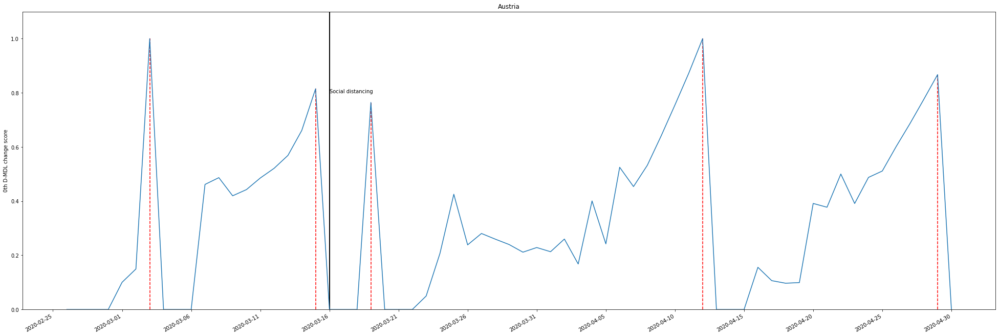

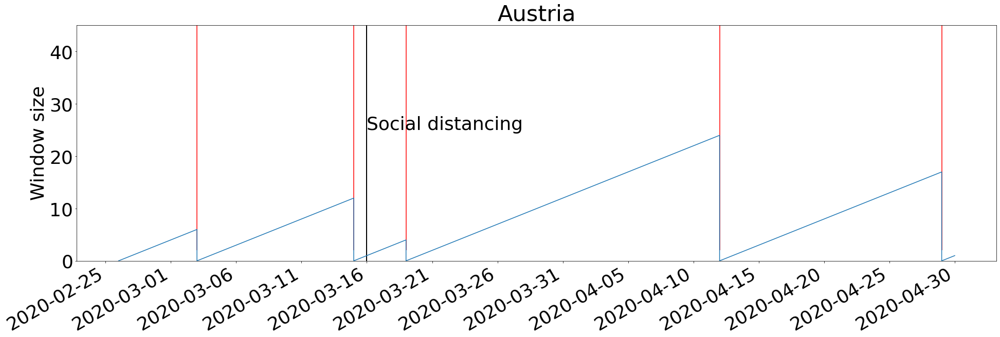

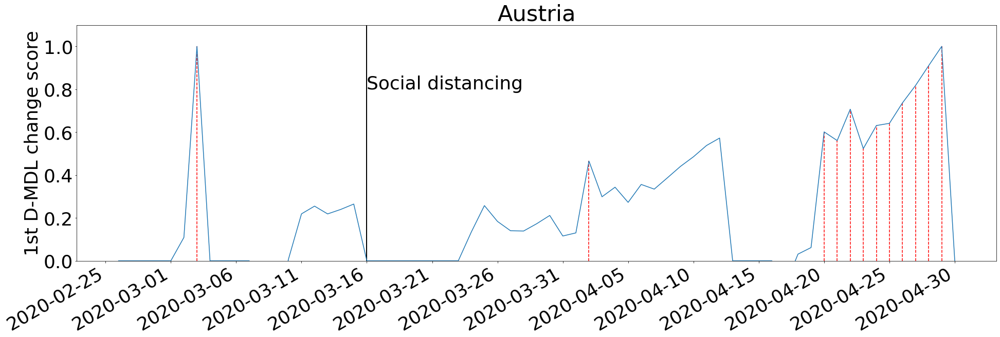

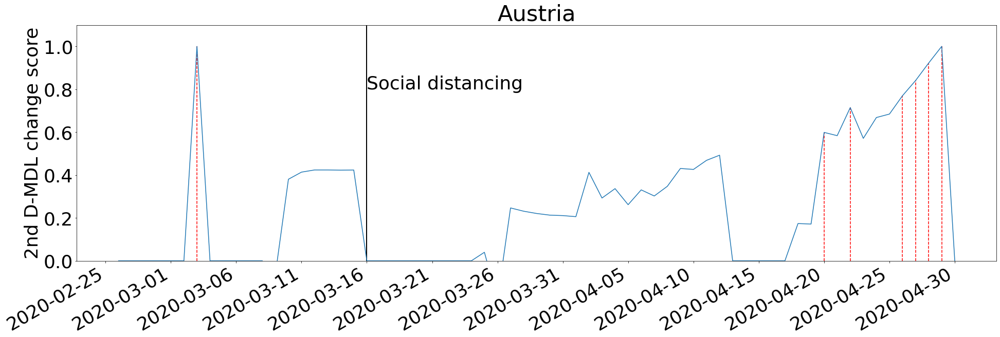

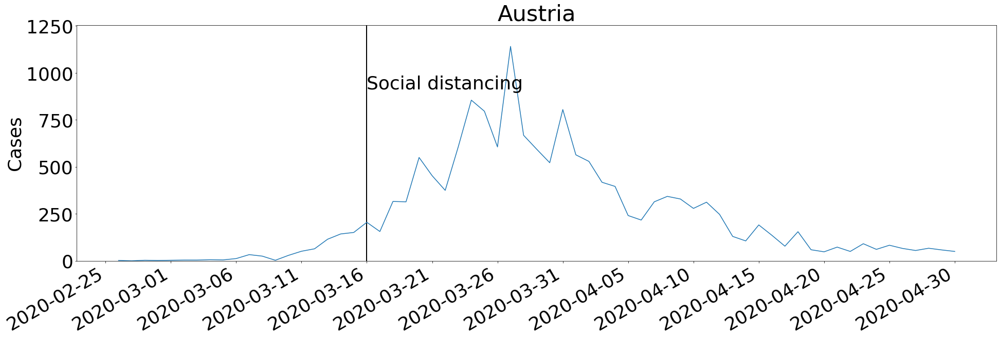

...

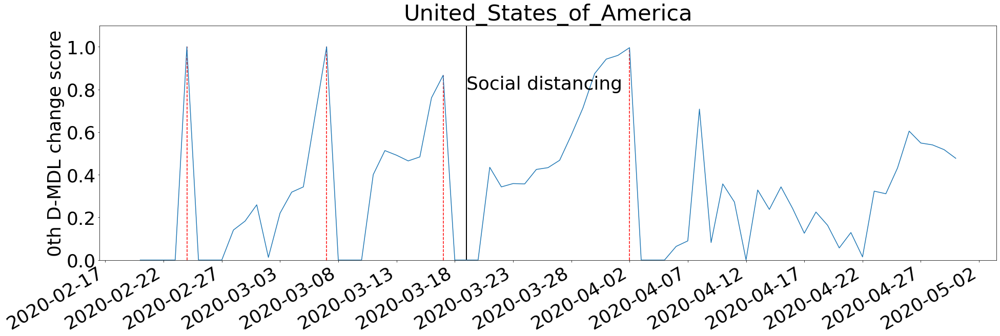

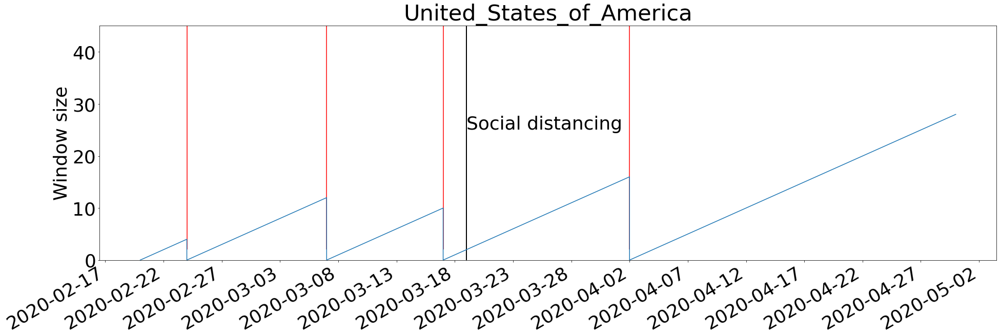

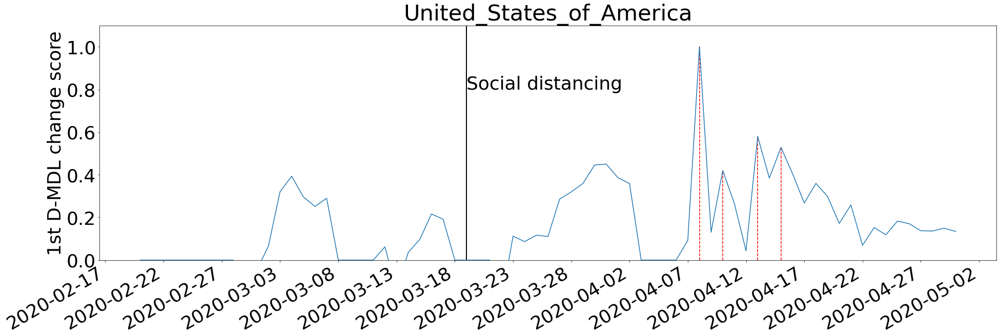

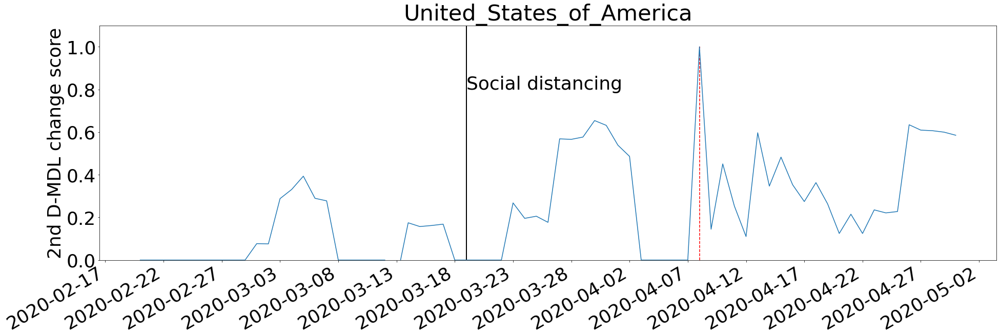

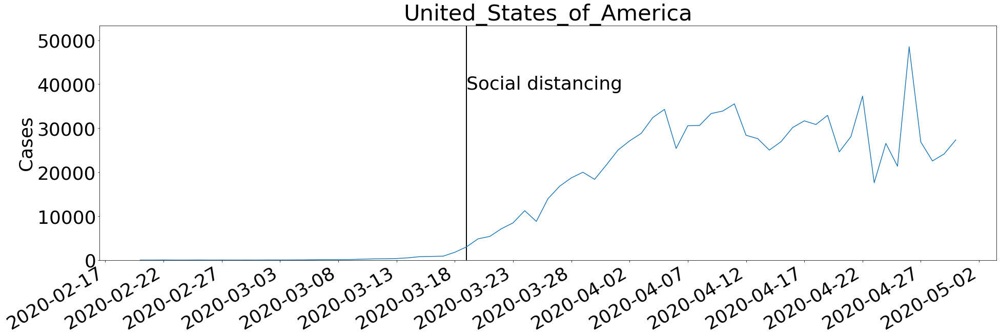

In [15]:
t = np.arange(datetime(2020, 1, 1), datetime(2020, 5, 1), timedelta(days=1)) ## The timeline for online detection
num_change_dict = {} # number of change points before event
num_0th_change_dict = {} # number of 0th change points before event
num_1st_change_dict = {} # number of 1st change points before event
num_2nd_change_dict = {} # number of 2nd change points before event

decrease_dict = {} # the day on which the first decrease change point raised by 0th for countries with event
decrease_no_event_dict = {} # the day on which the first decrease change raised by 0th for countries without event

days_between_zero_earliest = [] # days between the 0th change and the first either 1th or 2nd change within the window
days_between_zero_first = [] # days between the 0th change and the first 1th change within the window
days_between_zero_second = [] # days between the 0th change and the first 2nd change within the window

first_candidate_num = 0 # candicate outbreak allowing for 1st sign detection
first_detected_num = 0 # number of outbreaks whose signs are detected by 1st D-MDL
second_candidate_num = 0 # candicate outbreak allowing for 2nd sign detection
second_detected_num = 0 # number of outbreaks whose signs are detected by 2nd D-MDL
detected_num = 0  # number of outbreaks whose signs are detected by either 1st D-MDL or 2nd D-MDL
candidate_num = 0 # candicate outbreak allowing for both 1st and 2nd sign detection


for country in candidates_country:
    print('country:', country)
    if country in event_dict:
        dates_events = event_dict[country]       
    
    
    ##Determine the starting point of the detection
    ## Dates on which there are no daily new cases and the avearage daily new cases over the past 10 ten days is less than one is skipped.
    t_candidates = []
    t_num = []
    for date_tmp in t:
        row = df_candidates.loc[(df_candidates['country'] == country) & (df_candidates['date'] == date_tmp)]
        if len(row[category].values) > 0 and (row[category].values[0] > 0):
            t_candidates.append(date_tmp)
            t_num.append(row[category].values[0])  
        else:
            if len(t_num) <= 10 and np.mean(t_num) <= 1:
                t_candidates = []
                t_num = []
            else:
                t_candidates.append(date_tmp)
                t_num.append(0)
    
    print(t_candidates)
    
    
    case_values = {}
    case_max = 0
    max_date = 0
    for date_tmp in t:
        if date_tmp in t_candidates:
            row = df_candidates.loc[(df_candidates['country'] == country) & (df_candidates['date'] == date_tmp)]
            if len(row[category].values) > 0 and (row[category].values[0] > 0):
                case_values[date_tmp] = row[category].values[0]  
                if case_max < row[category].values[0]:
                    case_max = row[category].values[0]
                    max_date = date_tmp
            else:
                case_values[date_tmp] = 0
     
    
    dict_changes_cases = {}
    dic_windows_cases = {}
    MDL_scores_cases = []
    dates_tmp_cases = []
    windows_cases = []

    dict_first_changes_cases = {}
    dict_first_windows_cases = {}
    MDL_first_scores_cases = []
    dates_tmp_cases_first = []

    dict_second_changes_cases = {}
    dict_second_windows_cases = {}
    MDL_second_scores_cases = []
    dates_tmp_cases_second = []

    window_minimal = 4
    window_size = 0
    num_changes_before_event = 0
    num_0th_changes_before_event = 0
    num_1st_changes_before_event = 0
    num_2nd_changes_before_event = 0
    for date_tmp in t:
        if date_tmp in t_candidates:
            dates_tmp_cases.append(date_tmp)
            dates_tmp_cases_first.append(date_tmp)
            dates_tmp_cases_second.append(date_tmp)
            
            ## 0th D-MDL
            if window_size >= window_minimal:
                t_tmp = np.arange(date_tmp - np.timedelta64(window_size - 1,'D'), date_tmp + np.timedelta64(1,'D'), timedelta(days=1))#.astype(datetime)
                tmp_case_values = []
                for d in t_tmp:
                    if d in case_values:
                        tmp_case_values.append(case_values[d])
                    else:
                        tmp_case_values.append(0)
                
                MDL_max, cut_point = MDL_gaussian_0th(tmp_case_values)
                MDL_scores_cases.append(MDL_max) 

                windows_cases.append(window_size)
                threshold_tmp = threshod_MDL(delta, dimension, window_size)
                print('date:{0}, window size:{1}, threshold:{2}, MDL score:{3}'.format(date_tmp, window_size, threshold_tmp, MDL_max))

                #### first order ####
                if window_size >= 5:
                    MDL_max_first, t_cut_first = MDL_gaussian_1th(tmp_case_values)

                    MDL_first_scores_cases.append(MDL_max_first) 
                    threshold_tmp_first = threshod_F_MDL(delta_first, dimension, window_size)
                    if threshold_tmp_first < 0:
                        threshold_tmp_first = 1e-12
                    print('frist-orde change: date:{0}, threshold:{1}, MDL score:{2}'.format(date_tmp, threshold_tmp_first, MDL_max_first))

                    if MDL_max_first >= threshold_tmp_first:
                        dict_first_changes_cases[dates_tmp_cases[-1]] = MDL_max_first
                        dict_first_windows_cases[dates_tmp_cases[-1]] = t_cut_first 
                        if country in event_dict:
                            if date_tmp < event_dict[country]:
                                num_changes_before_event += 1
                                num_1st_changes_before_event += 1
                                
                        
                else:
                    MDL_first_scores_cases.append(0)
                #### end of first order ####

                #### second order ####
                if window_size >= 6:
                    MDL_max_second, t_cut_second = MDL_gaussian_2nd(tmp_case_values)
                    MDL_second_scores_cases.append(MDL_max_second) 

                    threshold_tmp_second = threshod_S_MDL(delta_second, dimension, window_size)
                    if threshold_tmp_second < 0:
                        threshold_tmp_second = 1e-12
                    print('second-orde change: date:{0}, threshold:{1}, MDL score:{2}'.format(date_tmp, threshold_tmp_second, MDL_max_second))

                    if MDL_max_second >= threshold_tmp_second:
                        dict_second_changes_cases[dates_tmp_cases[-1]] = MDL_max_second
                        dict_second_windows_cases[dates_tmp_cases[-1]] = t_cut_second
                        if country in event_dict:
                            if date_tmp < event_dict[country]:
                                num_changes_before_event += 1
                                num_2nd_changes_before_event += 1
                                
                         
                else:
                    MDL_second_scores_cases.append(0)
                #### end of second order ####

                window_size += 1
                if MDL_max >= threshold_tmp:
                    dict_changes_cases[dates_tmp_cases[-1]] = MDL_max
                    dic_windows_cases[dates_tmp_cases[-1]] = window_size 
                    
                    mean_before = np.mean(tmp_case_values[:cut_point])
                    mean_after = np.mean(tmp_case_values[cut_point:])
                    if mean_before < mean_after:
                        flag_first = False
                        flag_second = False
                    
                        candidate_num += 1
                        if window_size >= 6:
                            first_candidate_num += 1
                            for candidate in t_tmp:
                                if candidate in dict_first_changes_cases:
                                    days_tmp_first = (dates_tmp_cases[-1].astype(datetime) - candidate.astype(datetime)).days
                                    days_between_zero_first.append(days_tmp_first)
                                    days_between_zero_earliest.append(days_tmp_first)
                                    first_detected_num += 1
                                    flag_first = True
                                    break
                            
                        if window_size >= 7:
                            second_candidate_num += 1
                            for candidate in t_tmp:
                                if candidate in dict_second_changes_cases:
                                    days_tmp_second = (dates_tmp_cases[-1].astype(datetime) - candidate.astype(datetime)).days
                                    days_between_zero_second.append(days_tmp_second)
                                    if flag_first and days_tmp_second > days_tmp_first:
                                        days_between_zero_earliest = days_between_zero_earliest[:-1]
                                        days_between_zero_earliest.append(days_tmp_second)
                                    if not flag_first:
                                        days_between_zero_earliest.append(days_tmp_second)
                                    second_detected_num += 1
                                    flag_second = True
                                    break
                                    
                            
                            
                        if flag_first or flag_second:
                            detected_num += 1

                        flag_first = False
                        flag_second = False
                    
                    window_size = 1
                    dates_tmp_cases.append(dates_tmp_cases[-1]) ## for the change point to have to window sizes
                    MDL_scores_cases.append(MDL_max) ## for the change point to have to window sizes
                    windows_cases.append(window_size-1) 

                    ##statistics
                    if country in event_dict:
                        if date_tmp < event_dict[country]:
                            num_changes_before_event += 1
                            num_0th_changes_before_event += 1
                        
                        
                        if country not in decrease_dict:
                            mean_before = np.mean(tmp_case_values[:cut_point])
                            mean_after = np.mean(tmp_case_values[cut_point:])
                            if max_date < date_tmp and date_tmp > event_dict[country] and mean_before > mean_after:
                                decrease_dict[country] = date_tmp
                                #print('data:{}, mean before:{}, mean after:{}'.format(date_tmp, mean_before, mean_after))
                    else:
                        if country not in decrease_no_event_dict:
                            mean_before = np.mean(tmp_case_values[:cut_point])
                            mean_after = np.mean(tmp_case_values[cut_point:])
                            if max_date < date_tmp and mean_before > mean_after:
                                decrease_no_event_dict[country] = date_tmp
                                

                      

            else:
                print('date:{0}, window size:{1}, MDL score:{2}'.format(date_tmp, window_size, 0))
                MDL_scores_cases.append(0)
                windows_cases.append(window_size)
                window_size += 1

                MDL_first_scores_cases.append(0)
                MDL_second_scores_cases.append(0)
    
    if country in event_dict:
        num_change_dict[country] = num_changes_before_event
        num_0th_change_dict[country] = num_0th_changes_before_event
        num_1st_change_dict[country] = num_1st_changes_before_event
        num_2nd_change_dict[country] = num_2nd_changes_before_event
    
    
    ##### zero figure
    ### Some change scores at the beginning of the detection may be infinity because 
    ### the standard deviation is zero due to the same number of daily new cases, e.g., 1 
    max_mdl = 0
    for tmp_mdl in MDL_scores_cases:
        if tmp_mdl > max_mdl and tmp_mdl != float('inf'):
            max_mdl = tmp_mdl
    
    MDL_scores_cases = [x if x != float('inf') else max_mdl for x in MDL_scores_cases]
    MDL_scores_cases[:] /= max_mdl
    
    for key in dict_changes_cases:
        if dict_changes_cases[key] == float('inf'):
            dict_changes_cases[key] = max_mdl
        dict_changes_cases[key] = dict_changes_cases[key] / max_mdl
    
    
    plt.figure(figsize=(28,10))
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(dates_tmp_cases, MDL_scores_cases) # replace X-DATES and Y-VALUES with the variable names
    plt.gcf().autofmt_xdate()
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
    plt.ylabel('0th D-MDL change score')

    change_index = 1
    for key in dict_changes_cases:
        plt.vlines(key, ymin=0, ymax=dict_changes_cases[key], color='r', linestyle='--')
        change_index += 1

    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=1.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, 0.8, 'Social distancing', color='black')

    plt.ylim(0,1.1)
    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.tight_layout()
    if country == 'South Korea' or country == 'United Kingdom' or country == 'United States':
        plt.savefig(output_path+country.replace(' ', '_')+'_zero.eps')
    else:
        plt.savefig(output_path+country+'_0_score.eps')
    
    
    ## window figure
    plt.figure(figsize=(28,10))
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(dates_tmp_cases, windows_cases)
    plt.gcf().autofmt_xdate()
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
    plt.ylabel('Window size')


    for key in dic_windows_cases:
        plt.vlines(key, ymin=2, ymax=45.1, color='r', linestyle='-')

    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=45.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, 25.1, 'Social distancing', color='black')

    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.ylim(0,45.1)
    plt.tight_layout()
    if country == 'South Korea' or country == 'United Kingdom' or country == 'United States':
        plt.savefig(output_path+country.replace(' ', '_')+'_window.eps')
    else:
        plt.savefig(output_path+country+'_window_size.eps')
    
    
    ##first order figure
    max_first_mdl = 0
    for tmp_mdl in MDL_first_scores_cases:
        if tmp_mdl > max_first_mdl and tmp_mdl != float('inf'):
            max_first_mdl = tmp_mdl
    
    MDL_first_scores_cases = [x if x != float('inf') else max_first_mdl for x in MDL_first_scores_cases]
    
    #MDL_first_max = np.max(MDL_first_scores_cases)
    MDL_first_scores_cases[:] /= max_first_mdl
    
    
    for key in dict_first_changes_cases:
        if dict_first_changes_cases[key] == float('inf'):
            dict_first_changes_cases[key] = max_first_mdl
        dict_first_changes_cases[key] = dict_first_changes_cases[key] / max_first_mdl
        
    
    plt.figure(figsize=(28,10))

    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(dates_tmp_cases_first, MDL_first_scores_cases)
    plt.gcf().autofmt_xdate()
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
    plt.ylabel('1st D-MDL change score')

    change_index = 1
    for key in dict_first_changes_cases:
        plt.vlines(key, ymin=0, ymax=dict_first_changes_cases[key], color='r', linestyle='--')
        change_index += 1

    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=1.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, 0.8, 'Social distancing', color='black')

    plt.ylim(0,1.1)
    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.tight_layout()
    if country == 'South Korea' or country == 'United Kingdom' or country == 'United States':
        plt.savefig(output_path+country.replace(' ', '_')+'_first.eps')
    else:
        plt.savefig(output_path+country+'_1_score.eps')
    
    
    ### second order figure
    max_second_mdl = 0
    for tmp_mdl in MDL_second_scores_cases:
        if tmp_mdl > max_second_mdl and tmp_mdl != float('inf'):
            max_second_mdl = tmp_mdl
    
    MDL_second_scores_cases = [x if x != float('inf') else max_second_mdl for x in MDL_second_scores_cases]
    
    #MDL_first_max = np.max(MDL_first_scores_cases)
    MDL_second_scores_cases[:] /= max_second_mdl
    
    for key in dict_second_changes_cases:
        if dict_second_changes_cases[key] == float('inf'):
            dict_second_changes_cases[key] = max_second_mdl
        dict_second_changes_cases[key] = dict_second_changes_cases[key] / max_second_mdl
    
    
    plt.figure(figsize=(28,10))
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(dates_tmp_cases_second, MDL_second_scores_cases)
    plt.gcf().autofmt_xdate()
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
    plt.ylabel('2nd D-MDL change score')

    change_index = 1
    for key in dict_second_changes_cases:
        plt.vlines(key, ymin=0, ymax=dict_second_changes_cases[key], color='r', linestyle='--')
        #plt.text(key, dict_second_changes_cases[key]+0.025, str(change_index), color='black', bbox=box)
        change_index += 1

    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=1.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, 0.8, 'Social distancing', color='black')

    plt.ylim(0,1.1)
    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.tight_layout()
    if country == 'South Korea' or country == 'United Kingdom' or country == 'United States':
        plt.savefig(output_path+country.replace(' ', '_')+'_second.eps')
    else:
        plt.savefig(output_path+country+'_2_score.eps')
    
    
    ### cases figure
    plt.figure(figsize=(28,10))
    case_day = []
    days = []
    for key in case_values:
        case_day.append(case_values[key])
        days.append(key)

    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d'))
    plt.gca().xaxis.set_major_locator(mdates.DayLocator(interval=5))
    plt.plot(days, case_day)
    plt.gcf().autofmt_xdate()
    plt.ylabel('Cases')
    if country == 'South_Korea':
         plt.title('South Korea')
    else:
        plt.title(country)
        
    if country in event_dict:
        plt.vlines(dates_events, ymin=0, ymax=np.max(case_day)*1.1, color='black', linestyle='-',linewidth=2)
        plt.text(dates_events, np.max(case_day)*0.8, 'Social distancing', color='black')

    plt.ylim(0,np.max(case_day)*1.1)
    plt.rc('font', size=font_size) 
    plt.rc('xtick', labelsize=font_size)    
    plt.rc('ytick', labelsize=font_size)
    plt.tight_layout()
    plt.savefig(output_path+country+'_case.eps')

## Calculation of statistics

In [16]:
## Number of alarms for non-downward countries
num_change_decrease = []
num_0th_change_decrease = []
num_1st_change_decrease = []
num_2nd_change_decrease = []
num_change_increase = []
num_0th_change_increase = []
num_1st_change_increase = []
num_2nd_change_increase = []
num_0th_days_before_event_decrease = []
num_1st_days_before_event_decrease = []
num_2nd_days_before_event_decrease = []
num_0th_days_before_event_increase = []
num_1st_days_before_event_increase = []
num_2nd_days_before_event_increase = []
num_days_event_to_decrease = []
num_days_increase_to_decrease_event = []
num_days_increase_to_decrease_no_event = []
for key in candidates_country:
    if key in event_dict:
        if key in decrease_dict:
            print('country:{0}, change num:{1}, event-decrease:{2}'.format(key, num_change_dict[key],(decrease_dict[key].astype(datetime) - event_dict[key]).days))
            num_change_decrease.append(num_change_dict[key])
            if key in num_0th_change_dict:
                num_0th_change_decrease.append(num_0th_change_dict[key])
            else:
                num_0th_change_decrease.append(0)
                
            if key in num_1st_change_dict:
                num_1st_change_decrease.append(num_1st_change_dict[key])
            else:
                num_1st_change_decrease.append(0)
                
            if key in num_2nd_change_dict:
                num_2nd_change_decrease.append(num_2nd_change_dict[key])
            else:
                num_2nd_change_decrease.append(0)
            
            num_days_event_to_decrease.append((decrease_dict[key].astype(datetime) - event_dict[key]).days)
        else:
            num_change_increase.append(num_change_dict[key])
            if key in num_0th_change_dict:
                num_0th_change_increase.append(num_0th_change_dict[key])
            else:
                num_0th_change_increase.append(0)
                
            if key in num_1st_change_dict:
                num_1st_change_increase.append(num_1st_change_dict[key])
            else:
                num_1st_change_increase.append(0)
                
            if key in num_2nd_change_dict:
                num_2nd_change_increase.append(num_2nd_change_dict[key])
            else:
                num_2nd_change_increase.append(0)

country:Austria, change num:4, event-decrease:27
country:China, change num:3, event-decrease:25
country:Germany, change num:10, event-decrease:38
country:Iran, change num:4, event-decrease:19
country:Italy, change num:4, event-decrease:23
country:Netherlands, change num:5, event-decrease:43
country:South_Korea, change num:8, event-decrease:18
country:Spain, change num:4, event-decrease:35
country:Switzerland, change num:1, event-decrease:38
country:Turkey, change num:0, event-decrease:34


In [17]:
## Number of alarms for non-downward countries
for key in event_dict:
    if key not in decrease_dict:
        print('country:{0}, change num:{1}'.format(key, num_change_dict[key]))

country:Belarus, change num:8
country:Belgium, change num:2
country:Brazil, change num:4
country:Canada, change num:7
country:Chile, change num:12
country:France, change num:6
country:India, change num:2
country:Indonesia, change num:5
country:Ireland, change num:2
country:Israel, change num:2
country:Japan, change num:13
country:Mexico, change num:6
country:Pakistan, change num:5
country:Peru, change num:1
country:Poland, change num:4
country:Portugal, change num:6
country:Qatar, change num:6
country:Romania, change num:3
country:Russia, change num:8
country:Saudi_Arabia, change num:5
country:Singapore, change num:18
country:Sweden, change num:3
country:Ukraine, change num:0
country:United_Arab_Emirates, change num:6
country:United_Kingdom, change num:11
country:United_States_of_America, change num:3


In [18]:
## total number of alarms before the event for downward countries
np.mean(num_change_decrease), np.std(num_change_decrease)

(4.3, 2.7946377224964243)

In [19]:
## total number of alarms before the event for non-downward countries
np.mean(num_change_increase), np.std(num_change_increase)

(5.6923076923076925, 4.036079883798433)

In [20]:
#number of 0th alarms before the event for downward countries and non-downward ones, respectively
np.mean(num_0th_change_decrease), np.std(num_0th_change_decrease), np.mean(num_0th_change_increase), np.std(num_0th_change_increase)

(2.0, 1.5491933384829668, 2.0, 1.4142135623730951)

In [21]:
#number of 1th alarms before the event for downward countries and non-downward ones, respectively
np.mean(num_1st_change_decrease), np.std(num_1st_change_decrease),np.mean(num_1st_change_increase), np.std(num_1st_change_increase)

(1.7, 1.4177446878757824, 2.923076923076923, 2.3521361309877933)

In [22]:
#number of 2nd alarms before the event for downward countries and non-downward ones, respectively
np.mean(num_2nd_change_decrease), np.std(num_2nd_change_decrease),np.mean(num_2nd_change_increase), np.std(num_2nd_change_increase)

(0.6, 0.66332495807108, 0.7692307692307693, 1.2498520622516862)

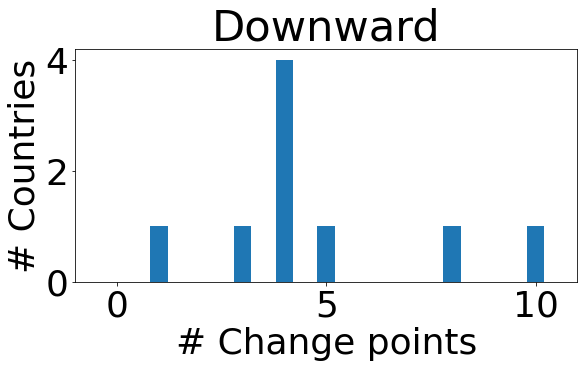

In [23]:
plt.figure(figsize=(9,6))
bins = np.arange(0.5, 11.5, 1) # fixed bin size
plt.xlim([min(num_change_decrease)-1, max(num_change_decrease)+1])
plt.hist(num_change_decrease, bins=bins, rwidth=0.422)
plt.ylabel('# Countries')
plt.xlabel('# Change points')
plt.title('Downward')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'decrease_change_before_event.eps')

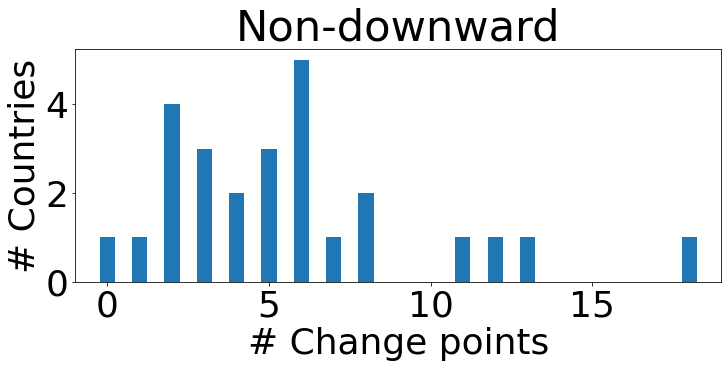

In [24]:
plt.figure(figsize=(11,6))
plt.xlim([min(num_change_increase)-1, max(num_change_increase)+1])
bins = np.arange(-0.5, 19.5, 1)
plt.hist(num_change_increase, bins=bins, rwidth=0.47)
plt.ylabel('# Countries')
plt.xlabel('# Change points')
plt.title('Non-downward')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'increase_change_before_event.eps')

In [25]:
## total number of outbreaks and number of outbreaks whose signs were detected by either the 1st or the 2nd D-MDL
candidate_num, detected_num

(114, 74)

In [26]:
##Total number of outbreaks that allowed for the 1st D-MDL sign detection and Number of outbreaks whose signs were detected by the 1st D-MDL
first_candidate_num, first_detected_num 

(96, 72)

In [27]:
##Total number of outbreaks that allowed for the 2nd D-MDL sign detection and Number of outbreaks whose signs were detected by the 2nd D-MDL
second_candidate_num, second_detected_num 

(88, 28)

In [28]:
## Number of days before an outbreak for the first sign of either the 1st or the 2nd D-MDL
np.mean(days_between_zero_earliest), np.std(days_between_zero_earliest), np.min(days_between_zero_earliest), np.max(days_between_zero_earliest)

(6.3108108108108105, 6.26859541937227, 0, 22)

In [29]:
## Number of days before an outbreak for the first sign of the 1st
np.mean(days_between_zero_first), np.std(days_between_zero_first), np.min(days_between_zero_first), np.max(days_between_zero_first)

(6.208333333333333, 5.98594998494159, 0, 22)

In [30]:
## Number of days before an outbreak for the first sign of the 2nd
np.mean(days_between_zero_second), np.std(days_between_zero_second), np.min(days_between_zero_second), np.max(days_between_zero_second)

(6.428571428571429, 7.223120474404056, 0, 22)

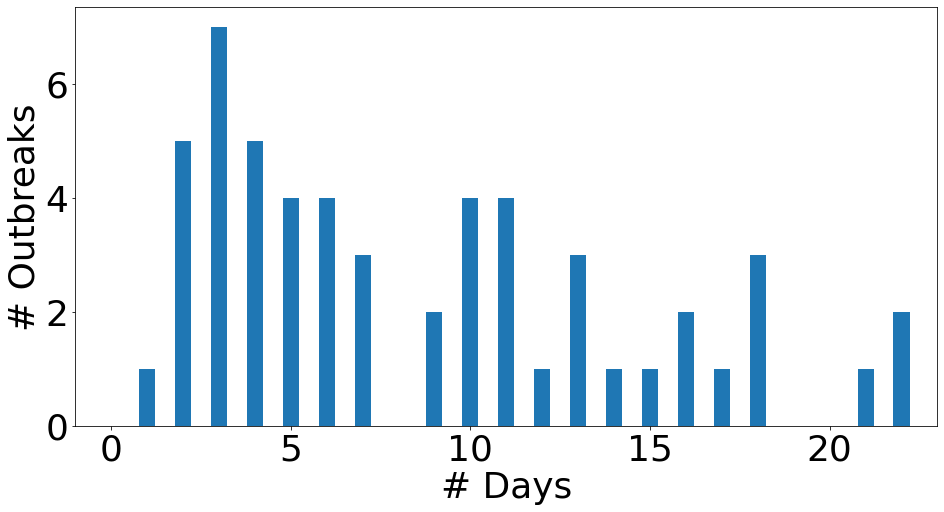

In [31]:
plt.figure(figsize=(14,8))
bins = np.arange(0.5, 23.5, 1) # fixed bin size
plt.xlim([min(days_between_zero_earliest)-1, max(days_between_zero_earliest)+1])
plt.hist(days_between_zero_earliest, bins=bins, rwidth=0.446)
plt.ylabel('# Outbreaks')
plt.xlabel('# Days')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'days_between_zero_earliest.eps')

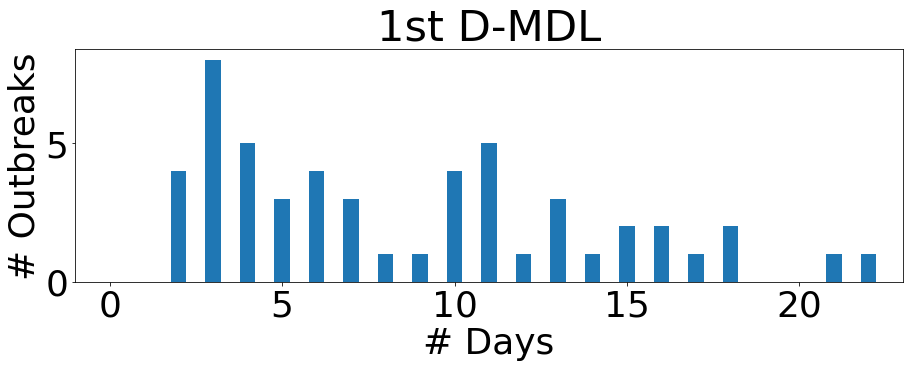

In [32]:
plt.figure(figsize=(14,6))
bins = np.arange(0.5, 23.5, 1) # fixed bin size
plt.xlim([min(days_between_zero_first)-1, max(days_between_zero_first)+1])
plt.hist(days_between_zero_first, bins=bins, rwidth=0.446)
plt.ylabel('# Outbreaks')
plt.xlabel('# Days')
plt.title('1st D-MDL')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'days_between_zero_first.eps')

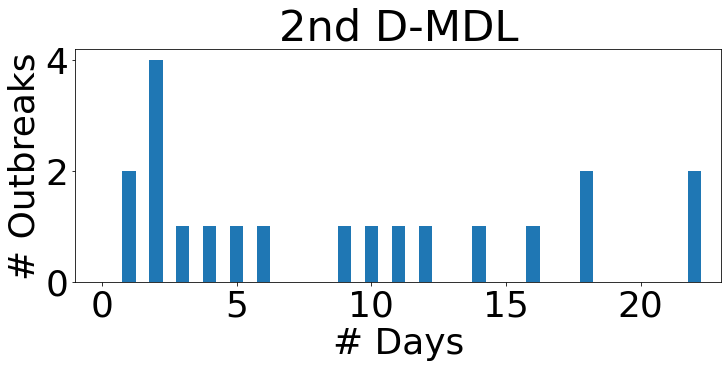

In [33]:
plt.figure(figsize=(11,6))
bins = np.arange(0.5, 23.5, 1) # fixed bin size
plt.xlim([min(days_between_zero_second)-1, max(days_between_zero_second)+1])
plt.hist(days_between_zero_second, bins=bins, rwidth=0.495)
plt.ylabel('# Outbreaks')
plt.xlabel('# Days')
plt.title('2nd D-MDL')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'days_between_zero_second.eps')

In [34]:
## Number of days from event’s date to the first downward change’s (0th D-MDL alarm)date
np.mean(num_days_event_to_decrease), np.std(num_days_event_to_decrease), np.max(num_days_event_to_decrease)

(30.0, 8.282511696339462, 43)

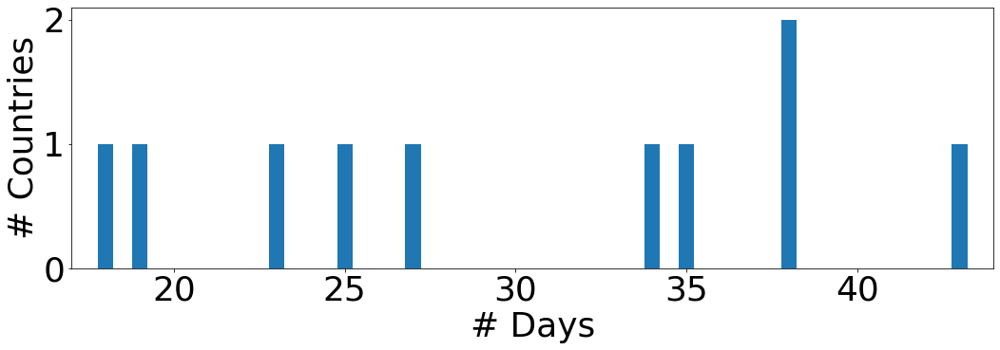

In [35]:
plt.figure(figsize=(15.5,6))
bins = np.arange(2.5, 44.5, 1) # fixed bin size
plt.xlim([min(num_days_event_to_decrease)-1, max(num_days_event_to_decrease)+1])
#plt.xticks(range(6))
plt.hist(num_days_event_to_decrease, bins=bins, rwidth=0.455)
plt.ylabel('# Countries')
plt.xlabel('# Days')
#plt.title('Days from event to ')
plt.rc('font', size=font_size) 
plt.rc('xtick', labelsize=font_size)    
plt.rc('ytick', labelsize=font_size)
plt.tight_layout()
plt.savefig(output_path+'days_event_to_decrease.eps')